In [1]:
import numpy as np
import mne
from glob import glob
import matplotlib.pyplot as plt
from matplotlib.backends.backend_pdf import PdfPages
import seaborn as sns
from scipy.stats import zscore, linregress, ttest_ind, ttest_rel, ttest_1samp
import pandas as pd
from mne.preprocessing.bads import _find_outliers
import os 
import joblib
import emd
import re
import scipy as sp
import statsmodels.api as sm
import statsmodels.formula.api as smf

OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


In [2]:
import sys
sys.path.append('/Users/alexandrafink/Documents/GraduateSchool/SaezLab/SWB/ephys_analysis/scripts/saez_python_pipeline/LFPAnalysis')

In [4]:
from LFPAnalysis import lfp_preprocess_utils, sync_utils, analysis_utils, nlx_utils

In [5]:
#set paths for analysis

#directory of current project 
swb_dir = '/Users/alexandrafink/Documents/GraduateSchool/SaezLab/SWB/'
#data directory - currently original paths
anat_dir = '/Users/alexandrafink/Documents/GraduateSchool/SaezLab/SWB/anat_recons/recon_labels/'
behav_dir = '/Users/alexandrafink/Documents/GraduateSchool/SaezLab/SWB/behavior_analysis/behavior_preprocessed/'
ephys_dir = '/Users/alexandrafink/Documents/GraduateSchool/SaezLab/SWB/ephys_analysis/data/'
#project dir to store (should be in base_dir)
save_path = '/Users/alexandrafink/Documents/GraduateSchool/SaezLab/SWB/ephys_analysis/figs/'



In [ ]:
#desired subjects
subj_ids = ['MS002','MS003','MS016','MS019','MS030']

### Load MS003 Epoched Data

In [6]:
subj_id = 'MS003'
load_path = f'{ephys_dir}{subj_id}/epoch_DecisionOnset.fif'
epochs = mne.read_epochs(load_path, preload=True)

/var/folders/xk/q5rxx0ld0hnc9gjlq1dhwqhw0000gn/T/ipykernel_20927/679950711.py:3: RuntimeWarning: This filename (/Users/alexandrafink/Documents/GraduateSchool/SaezLab/SWB/ephys_analysis/data/MS003/epoch_DecisionOnset.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  epochs = mne.read_epochs(load_path, preload=True)


In [32]:
epochs

Number of events,150
Events,DecisionOnset: 150
Time range,-1.000 – 4.000 sec
Baseline,off


In [22]:
epochs.ch_names

['lmolf9',
 'lacas11',
 'lacas12',
 'racas12',
 'lmcms1',
 'lmcms6',
 'lmcms10',
 'rmcms6',
 'rmcms10',
 'laimm6',
 'laimm12',
 'raimm7',
 'raimm14',
 'laglt6',
 'laglt10',
 'raglt4',
 'raglt10',
 'lsifo3',
 'lsifo5',
 'lsifo8',
 'rsifo8',
 'lacas1-lmolf1',
 'lacas10-laimm8',
 'lacas2-lmolf1',
 'lacas3-lmolf1',
 'lacas4-lacas8',
 'lacas5-lacas8',
 'lacas6-laimm8',
 'lacas7-laimm9',
 'lacas9-laimm8',
 'laglt1-laglt4',
 'laglt2-laglt4',
 'laglt3-laglt4',
 'laglt8-laglt7',
 'laglt9-laglt7',
 'laimm1-laglt5',
 'laimm10-laimm7',
 'laimm11-laimm7',
 'laimm2-laglt5',
 'laimm3-lmolf6',
 'laimm4-lsifo1',
 'laimm5-laimm8',
 'lhplt1-laglt4',
 'lhplt2-laglt4',
 'lhplt3-laglt4',
 'lhplt4-laglt5',
 'lhplt5-laglt7',
 'lhplt6-laglt7',
 'lhplt7-laglt7',
 'lhplt8-laglt7',
 'lhplt9-lsifo4',
 'lmcms3-lmcms2',
 'lmcms4-lmcms5',
 'lmcms8-lmcms7',
 'lmcms9-lmcms7',
 'lmolf2-lmolf1',
 'lmolf3-lmolf1',
 'lmolf4-lmolf6',
 'lmolf5-lmolf6',
 'lmolf7-lmolf6',
 'lmolf8-lmolf6',
 'lsifo2-lsifo1',
 'lsifo7-lsifo6',
 

In [41]:
# Set some spectrogram parameters 
freqs = np.logspace(*np.log10([4, 200]), num=20)
n_cycles = 4  
sr = 500.0 #prob shouldn't have subject_id in here since not in loop...
buf = 1.0
buf_ix = int(buf*sr)

In [53]:
# Explicitly define a list of analysis events and the baseline event. Should correspond to the dict
analysis_evs = ['DecisionOnset']
baseline_ev = 'TrialOnset'
evs = {'TrialOnset': [-1.0, 0.25],
       'DecisionOnset': [0, 3.0]}

In [54]:
event = 'TrialOnset'
baseline_power_epochs = {}

# Let's make sure we only do this for good channels
good_chans = [x for x in epochs.ch_names if x not in epochs.info['bads']]
picks = [x for x in good_chans]

pow_struct = np.nan * np.ones([epochs._data.shape[0], 
                       epochs._data.shape[1], len(freqs), 
                       epochs._data.shape[-1]])

for ch_ix in np.arange(epochs._data.shape[1]): 
    ch_data = epochs._data[:, ch_ix:ch_ix+1, :]
    bad_epochs  = np.where(epochs.metadata[epochs.ch_names[ch_ix]].notnull())[0]
    good_epochs = np.delete(np.arange(ch_data.shape[0]), bad_epochs)
    ch_data = np.delete(ch_data, bad_epochs, axis=0)
    ch_pow = mne.time_frequency.tfr_array_morlet(ch_data, sfreq=epochs.info['sfreq'], 
                                        freqs=freqs, n_cycles=n_cycles, zero_mean=False, 
                                        use_fft=True, output='power', n_jobs=1)

    pow_struct[good_epochs, ch_ix, :, :] = ch_pow[:, 0, :, :]

temp_pow = mne.time_frequency.EpochsTFR(epochs.info, pow_struct, 
                                        epochs.times, freqs)
temp_pow.crop(tmin=evs[event][0], tmax=evs[event][1])

baseline_power_epochs[event] = temp_pow

In [55]:
power_epochs = {}

for event in analysis_evs:


    # Let's make sure we only do this for good channels
    good_chans = [x for x in epochs.ch_names if x not in epochs.info['bads']]
    picks = [x for x in good_chans]

    pow_struct = np.nan * np.ones([epochs._data.shape[0], 
                           epochs._data.shape[1], len(freqs), 
                           epochs._data.shape[-1]])

    for ch_ix in np.arange(epochs._data.shape[1]): 
        ch_data = epochs._data[:, ch_ix:ch_ix+1, :]
        bad_epochs  = np.where(epochs.metadata[epochs.ch_names[ch_ix]].notnull())[0]
        good_epochs = np.delete(np.arange(ch_data.shape[0]), bad_epochs)
        ch_data = np.delete(ch_data, bad_epochs, axis=0)
        ch_pow = mne.time_frequency.tfr_array_morlet(ch_data, sfreq=epochs.info['sfreq'], 
                                            freqs=freqs, n_cycles=n_cycles, zero_mean=False, 
                                            use_fft=True, output='power', n_jobs=1)

        pow_struct[good_epochs, ch_ix, :, :] = ch_pow[:, 0, :, :]

    temp_pow = mne.time_frequency.EpochsTFR(epochs.info, pow_struct, 
                                            epochs.times, freqs)

    temp_pow.crop(tmin=evs[event][0], tmax=evs[event][1])

    baseline_corrected_power = lfp_preprocess_utils.zscore_TFR_across_trials(temp_pow.data, 
                                  baseline_power_epochs['TrialOnset'], mode='zscore', baseline_only=False)

    zpow = mne.time_frequency.EpochsTFR(epochs.info, baseline_corrected_power, 
                                    temp_pow.times, freqs)

    zpow.metadata = epochs.metadata

    power_epochs[event] = zpow

/Users/alexandrafink/Documents/GraduateSchool/SaezLab/SWB/ephys_analysis/scripts/saez_python_pipeline/LFPAnalysis/LFPAnalysis/lfp_preprocess_utils.py:138: RuntimeWarning: Mean of empty slice
  m = np.nanmean(np.nanmean(baseline_data, axis=time_axis), axis=ev_axis)
/Users/alexandrafink/opt/anaconda3/envs/swb_ephys/lib/python3.10/site-packages/numpy/lib/nanfunctions.py:1878: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,


## TFRs

### OFC

In [56]:
ofc_channels = ['lmolf2-lmolf1','lmolf3-lmolf1','lmolf4-lmolf6','rmolf3-rmolf2']

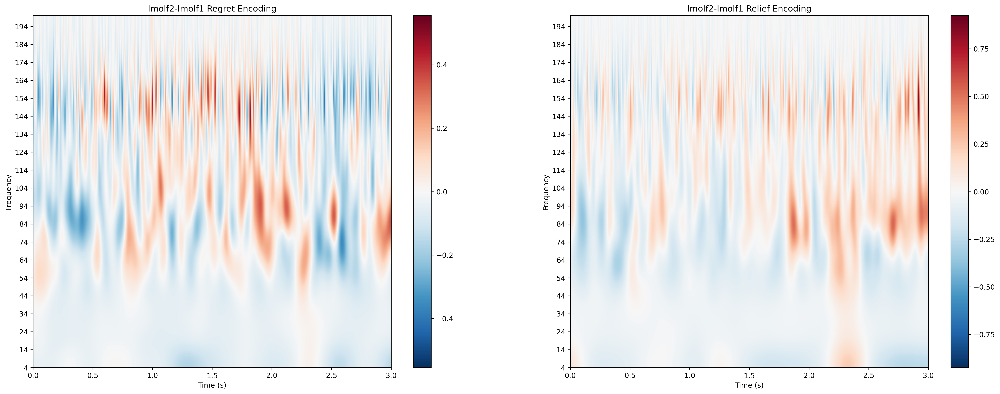

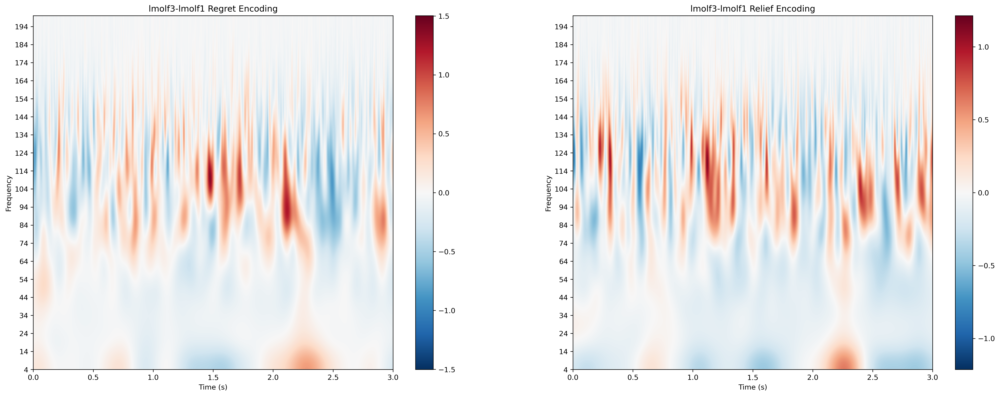

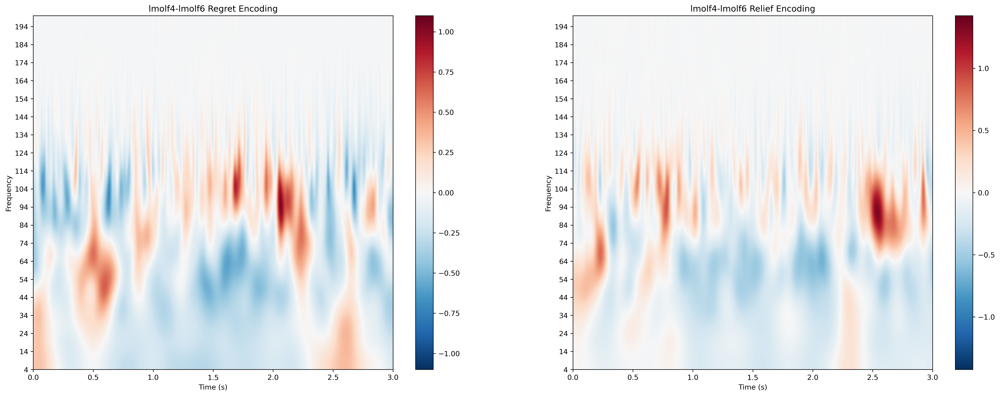

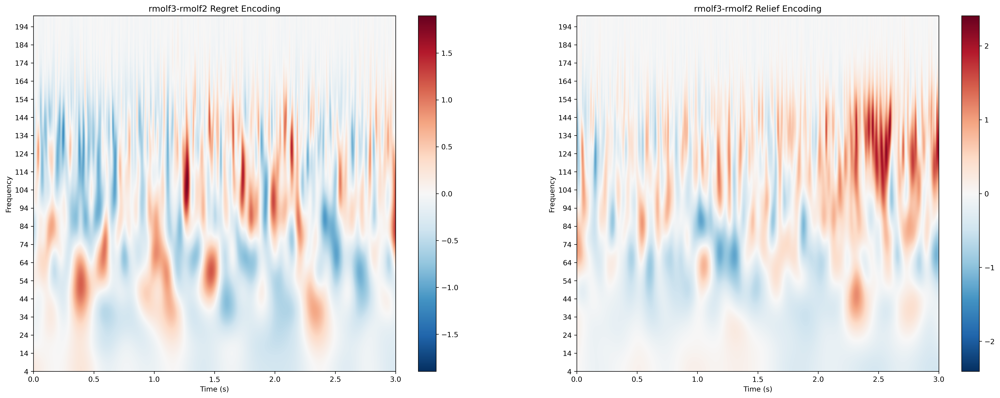

In [66]:
freqs = np.logspace(*np.log10([4, 200]), num=20)

yticks = np.arange(4,200,step=10)

conditions = ["(tregret<0)",
             "(tregret==0)"]

cond_name = 'regret'

for ch in ofc_channels:
    fig, ax = plt.subplots(1, 2, figsize=(25, 9), dpi=300)
    for ix, cond in enumerate(conditions):
        plot_title = ['Regret','Relief']
        # Set the times for 
        times = power_epochs[event].times
        plot_data = np.nanmean(np.nanmean(power_epochs[event][cond].copy().pick_channels([ch]).data, axis=0), axis=0)

        im = ax[ix].imshow(plot_data,
                extent=[times[0], times[-1], freqs[0], freqs[-1]], interpolation='Bicubic',
                aspect='auto', origin='lower', cmap='RdBu_r',vmin = -np.nanmax(np.abs(plot_data)), vmax = np.nanmax(np.abs(plot_data)))
        ax[ix].set(yticks=yticks, xlabel='Time (s)', ylabel='Frequency',title=f'{ch} {plot_title[ix]} Encoding')
        fig.colorbar(im, ax=ax[ix])

### ACC

In [60]:
acc_channels = ['lacas2-lmolf1','lacas3-lmolf1','lacas4-lacas8','lacas5-lacas8','racas2-rmolf5','racas3-rmolf5','racas4-racas9','racas5-rmolf2']


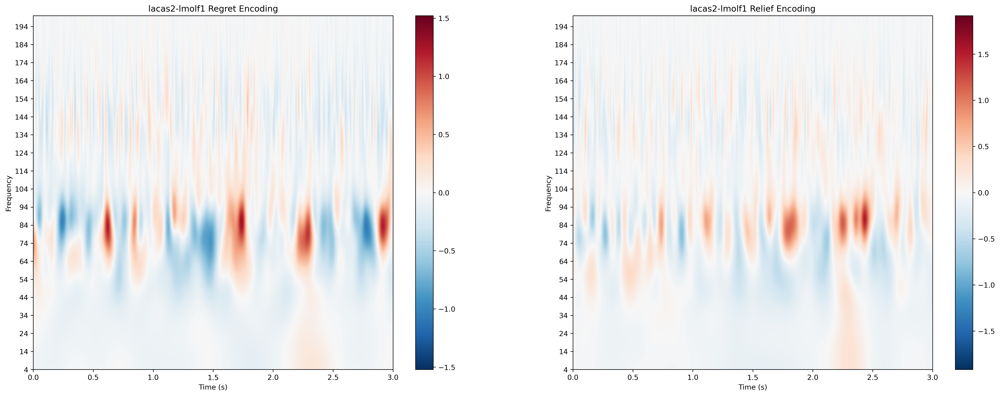

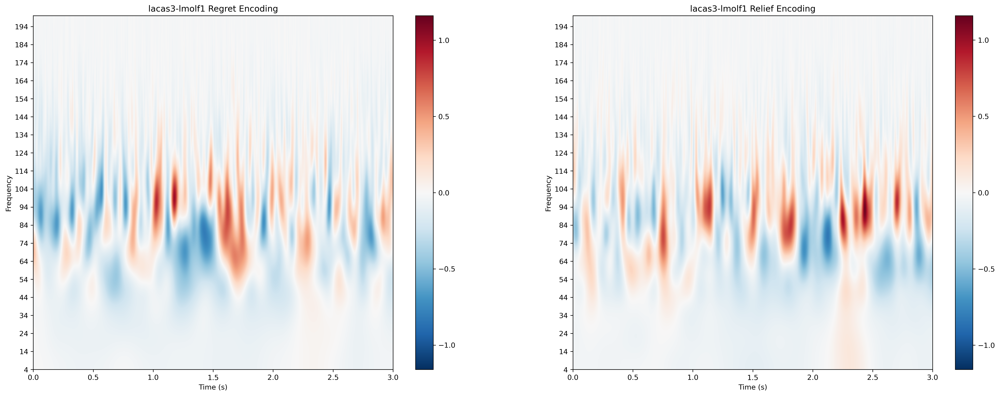

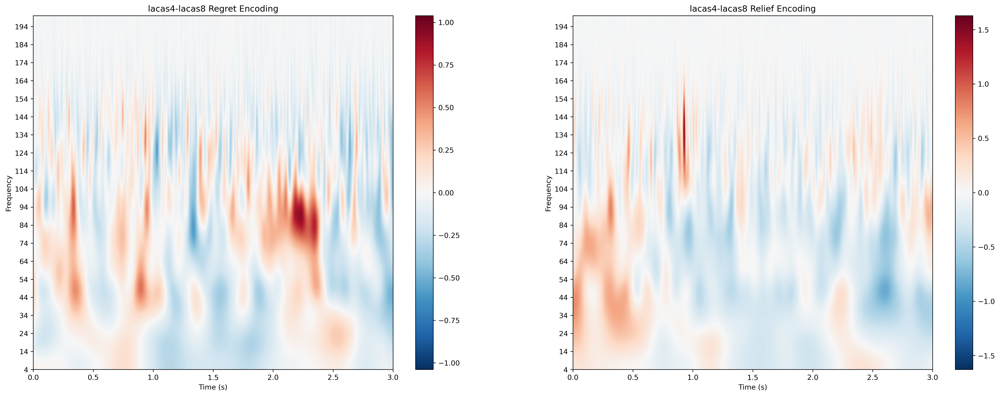

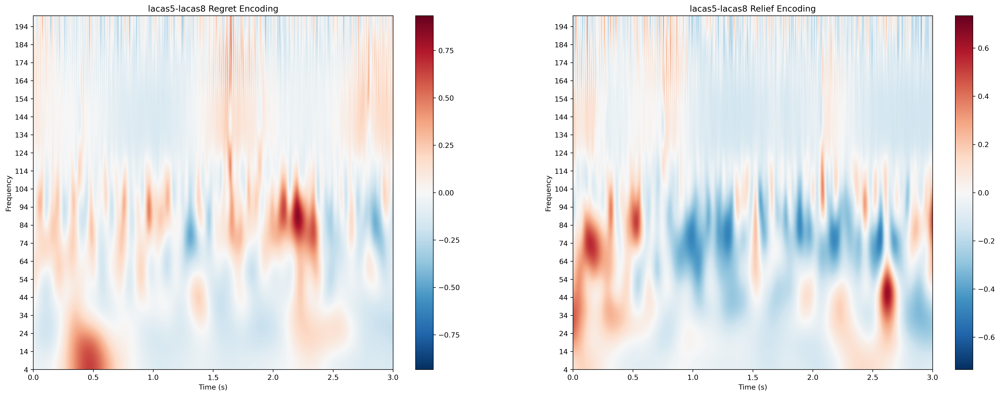

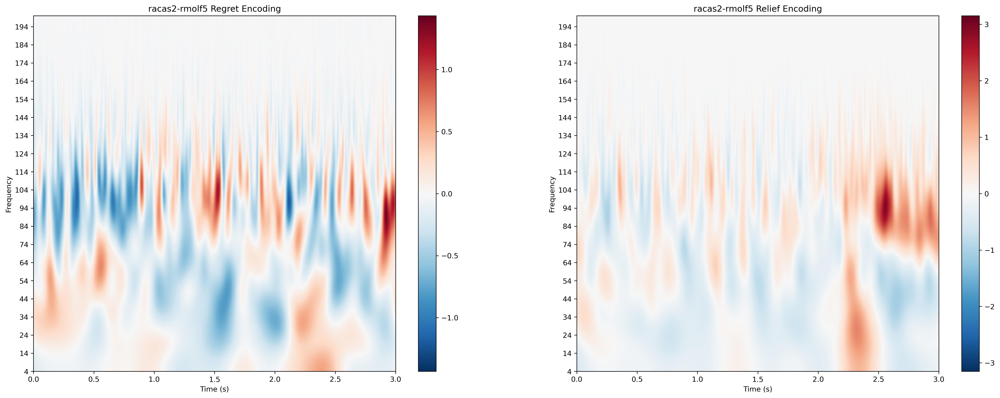

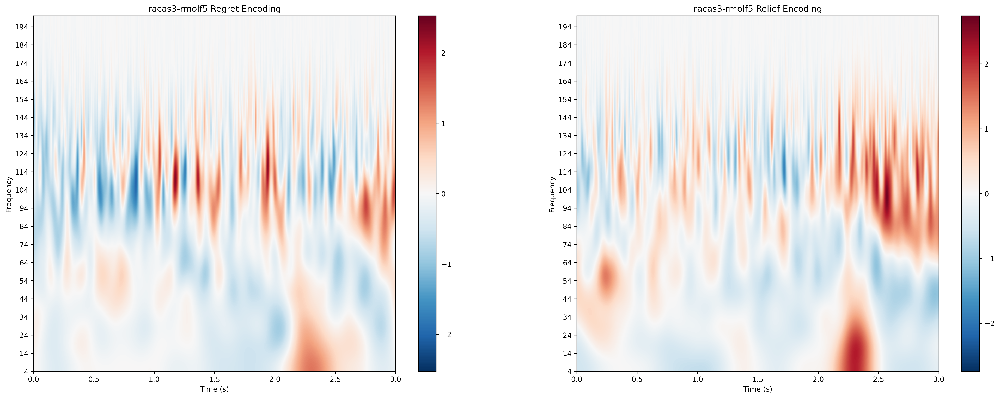

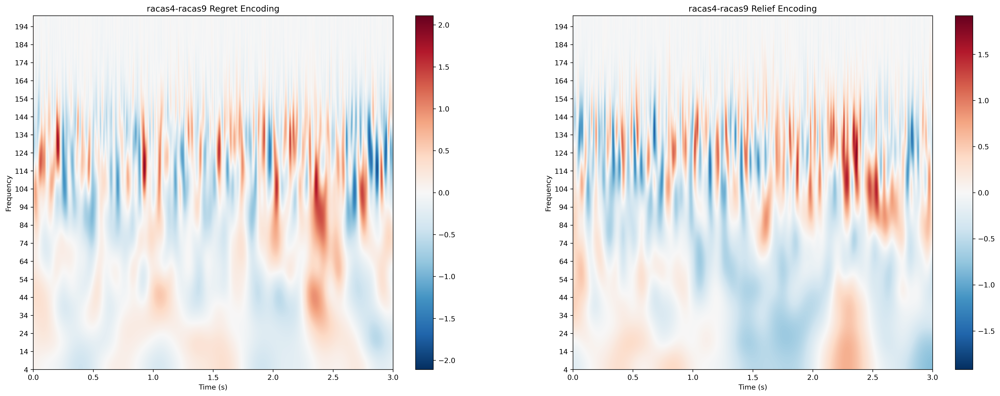

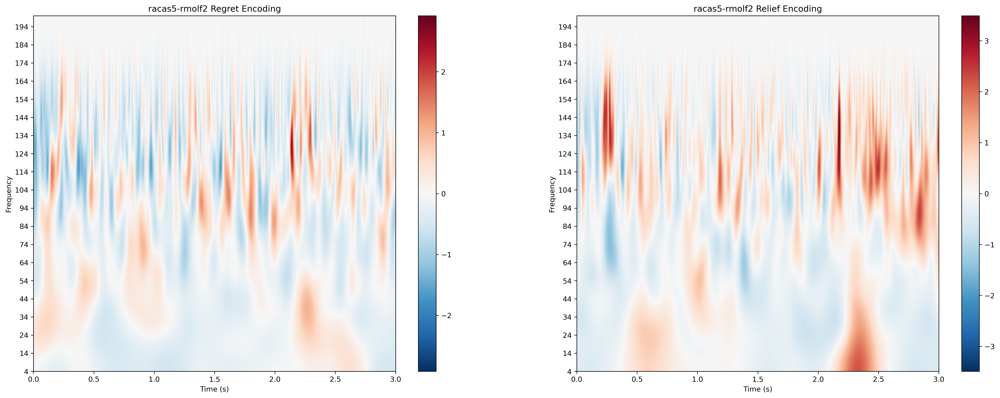

In [67]:
freqs = np.logspace(*np.log10([4, 200]), num=20)

yticks = np.arange(4,200,step=10)

conditions = ["(tregret<0)",
             "(tregret==0)"]

cond_name = 'regret'

for ch in acc_channels:
    fig, ax = plt.subplots(1, 2, figsize=(25, 9), dpi=300)
    for ix, cond in enumerate(conditions):
        plot_title = ['Regret','Relief']
        # Set the times for 
        times = power_epochs[event].times
        plot_data = np.nanmean(np.nanmean(power_epochs[event][cond].copy().pick_channels([ch]).data, axis=0), axis=0)

        im = ax[ix].imshow(plot_data,
                extent=[times[0], times[-1], freqs[0], freqs[-1]], interpolation='Bicubic',
                aspect='auto', origin='lower', cmap='RdBu_r',vmin = -np.nanmax(np.abs(plot_data)), vmax = np.nanmax(np.abs(plot_data)))
        ax[ix].set(yticks=yticks, xlabel='Time (s)', ylabel='Frequency',title=f'{ch} {plot_title[ix]} Encoding')
        fig.colorbar(im, ax=ax[ix])

### AMY

In [64]:
amy_channels = ['raglt1-rmolf2','raglt2-raglt8','raglt3-rsifo1']


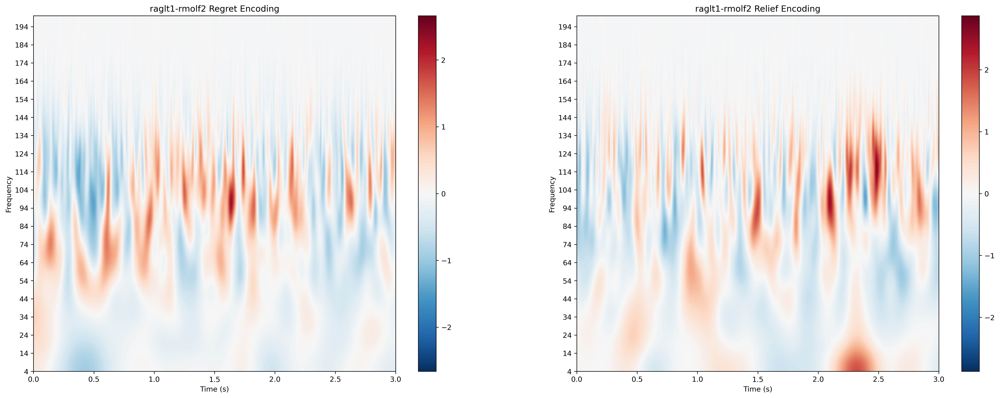

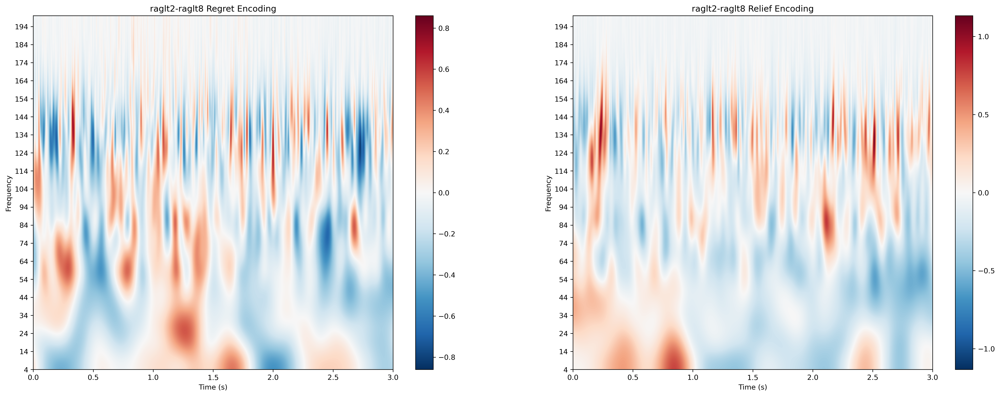

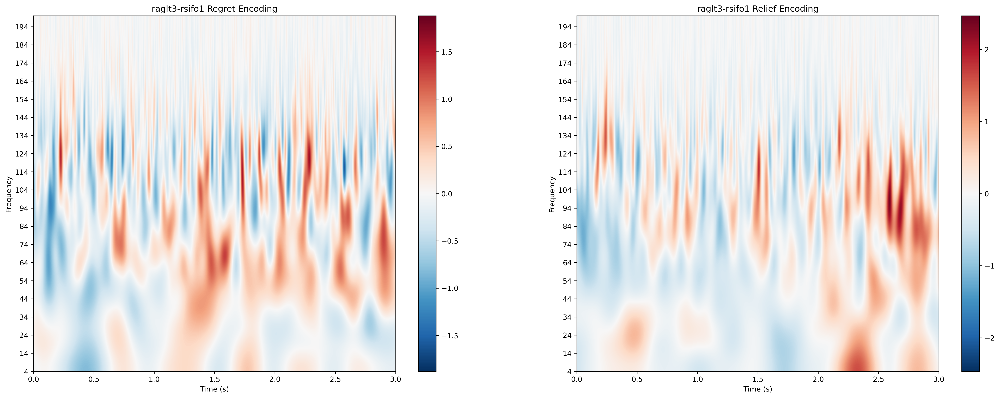

In [68]:
freqs = np.logspace(*np.log10([4, 200]), num=20)

yticks = np.arange(4,200,step=10)

conditions = ["(tregret<0)",
             "(tregret==0)"]

cond_name = 'regret'

for ch in amy_channels:
    fig, ax = plt.subplots(1, 2, figsize=(25, 9), dpi=300)
    for ix, cond in enumerate(conditions):
        plot_title = ['Regret','Relief']
        # Set the times for 
        times = power_epochs[event].times
        plot_data = np.nanmean(np.nanmean(power_epochs[event][cond].copy().pick_channels([ch]).data, axis=0), axis=0)

        im = ax[ix].imshow(plot_data,
                extent=[times[0], times[-1], freqs[0], freqs[-1]], interpolation='Bicubic',
                aspect='auto', origin='lower', cmap='RdBu_r',vmin = -np.nanmax(np.abs(plot_data)), vmax = np.nanmax(np.abs(plot_data)))
        ax[ix].set(yticks=yticks, xlabel='Time (s)', ylabel='Frequency',title=f'{ch} {plot_title[ix]} Encoding')
        fig.colorbar(im, ax=ax[ix])

### Ant Insula

In [69]:
ins_channels = ['laimm1-laglt5','laimm2-laglt5','laimm4-lsifo1','raimm2-rmolf5','raimm3-rmolf9','raimm4-rsifo1']


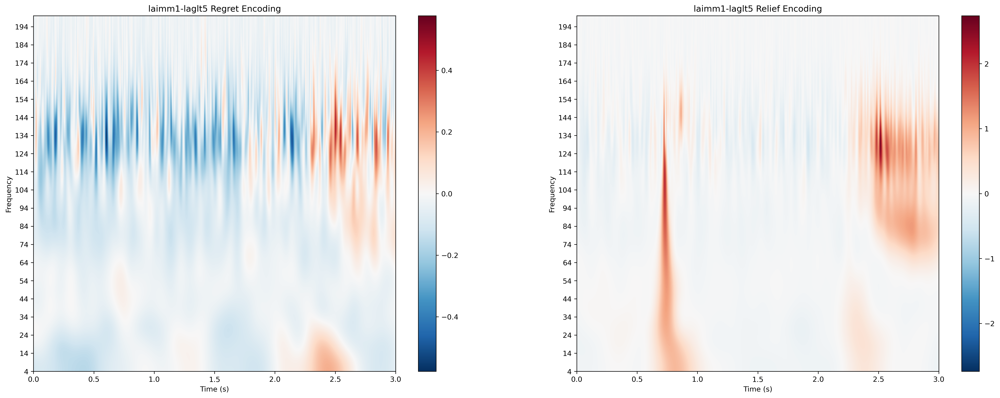

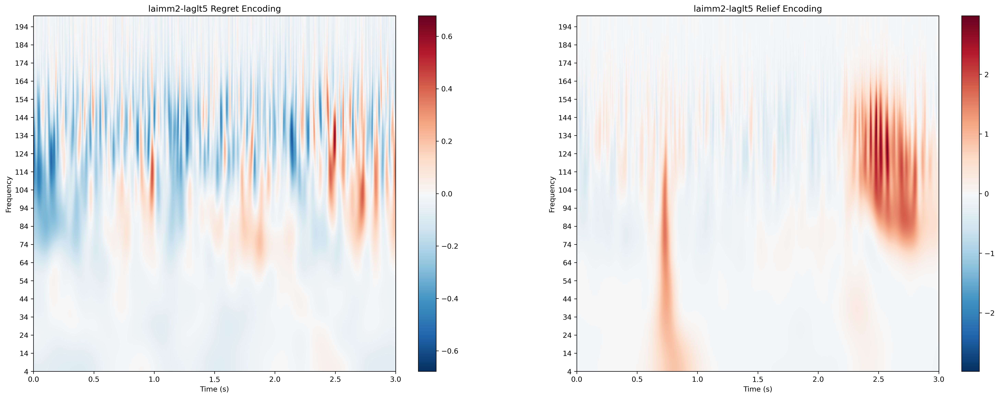

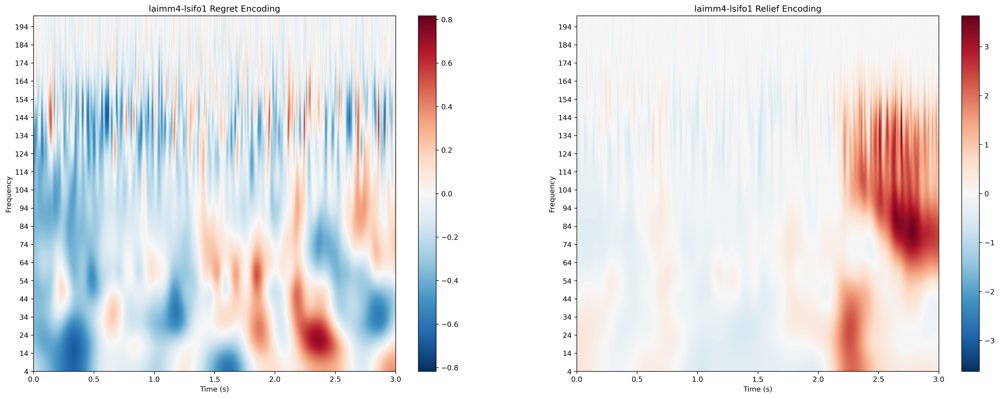

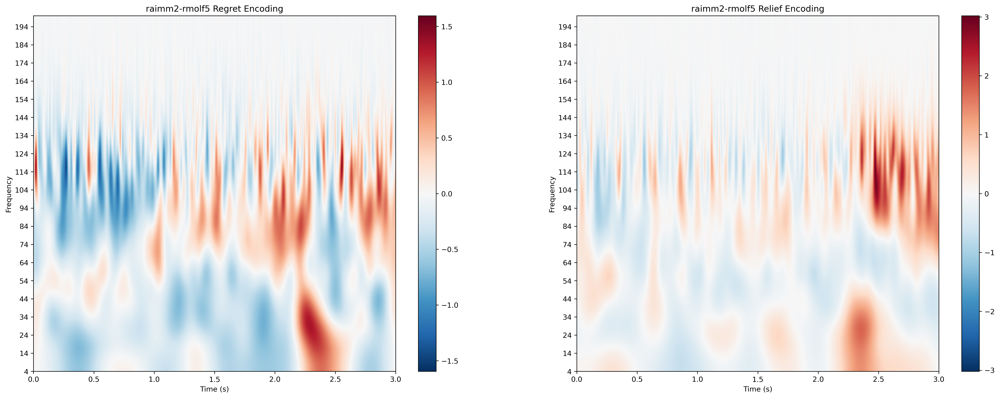

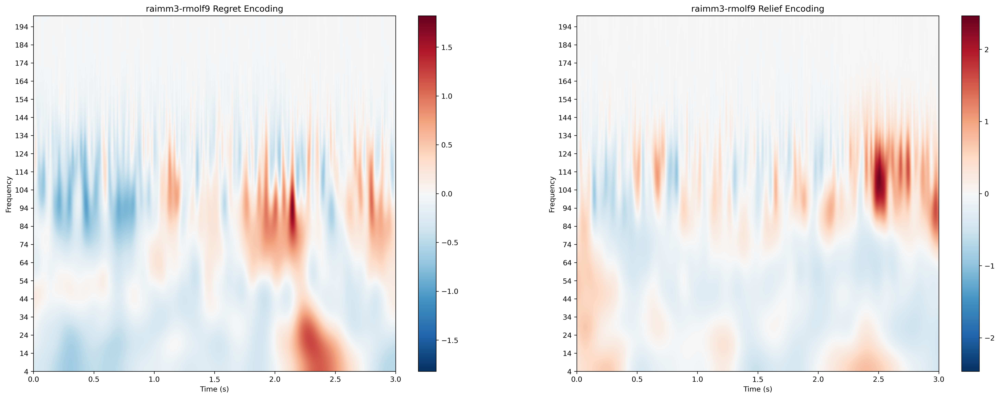

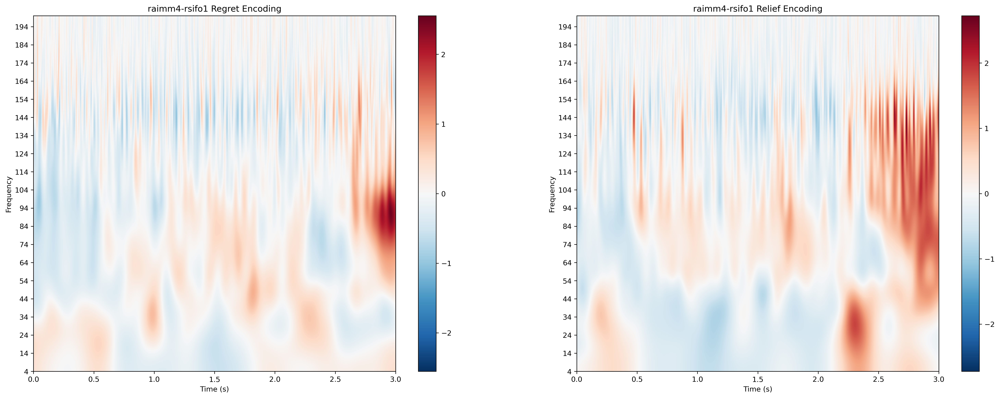

In [70]:
freqs = np.logspace(*np.log10([4, 200]), num=20)

yticks = np.arange(4,200,step=10)

conditions = ["(tregret<0)",
             "(tregret==0)"]

cond_name = 'regret'

for ch in ins_channels:
    fig, ax = plt.subplots(1, 2, figsize=(25, 9), dpi=300)
    for ix, cond in enumerate(conditions):
        plot_title = ['Regret','Relief']
        # Set the times for 
        times = power_epochs[event].times
        plot_data = np.nanmean(np.nanmean(power_epochs[event][cond].copy().pick_channels([ch]).data, axis=0), axis=0)

        im = ax[ix].imshow(plot_data,
                extent=[times[0], times[-1], freqs[0], freqs[-1]], interpolation='Bicubic',
                aspect='auto', origin='lower', cmap='RdBu_r',vmin = -np.nanmax(np.abs(plot_data)), vmax = np.nanmax(np.abs(plot_data)))
        ax[ix].set(yticks=yticks, xlabel='Time (s)', ylabel='Frequency',title=f'{ch} {plot_title[ix]} Encoding')
        fig.colorbar(im, ax=ax[ix])

## Time Resolved Regression

In [82]:

def time_resolved_regression(timeseries=None, regressors=None, win_len=200, slide_len=50):
    """
    In this function, if you provide a 2D array of z-scored time-varying neural data and a set of regressors,
    this function will run a time-resolved generalized linear model with the provided regressor dataframe.

    Typically, this timeseries will be HFA, and the default win_len and slide_len reflect this

    timeseries: ndarray, trials x times
    regressors: pandas df, index = trials, columns = regressors
    """

    # Check the length of your time window:
    if timeseries.shape[1] % slide_len > 0:
        print('need to trim your timeseries or pick a neatly divisible window length')
        return

    # Smooth the timeseries
    smoothed_data = np.zeros([timeseries.shape[0], (timeseries.shape[1] // slide_len) - (win_len//slide_len - 1)])
    for trial in range(timeseries.shape[0]):
        smoothed_data[trial, :] = [np.nanmean(timeseries[trial, i:i+win_len]) for i in range(0, timeseries.shape[1], slide_len) if i+win_len <= timeseries.shape[1]]

    # Run the regression
    models = []
    for ts in range(smoothed_data.shape[1]):
        model_df = regressors.copy()
        model_df['dv'] = smoothed_data[:, ts]
        formula = f'dv ~ 1+'+'+'.join(regressors.columns)
        mod = smf.glm(formula=formula, data=model_df, family=sm.families.Gaussian()).fit()
        models.append(pd.DataFrame(mod.params).T)

    models = pd.concat(models)
    return models #df every regressors weights at every time point one channel at a time 

def time_resolved_regression_perm(timeseries=None, regressors=None, win_len=200, slide_len=50):

    models = time_resolved_regression(timeseries, regressors, win_len, slide_len, nsurr)

    # Generate permuted timeseries
    shuffles = np.random.randint(1, timeseries.shape[1], nsurr)
    all_surrs = [] #same thing but suffling 
    for surr in range(nsurr):
        # shuffle in time
        surr_ts = np.roll(timeseries, shuffles[surr], axis=1)
        # shuffle trials
        np.random.shuffle(surr_ts)
        # Re-run regression with permuted timeseries
        surr_models = time_resolved_regression(surr_ts, regressors, win_len, slide_len)
        all_surrs.append(surr_models)

    all_surrs = pd.concat(all_surrs)

    return all_surrs #compare permutation output to determine significance

In [51]:
epochs.metadata

,lmolf9,lacas11,lacas12,racas12,lmcms1,lmcms6,lmcms10,rmcms6,rmcms10,laimm6,...,c_ev,rpe,tcpe,dcpe,tregret,dregret,trelief,drelief,util_g,util_s
0,None,None,None,None,None,None,None,None,None,None,...,0.950,-0.950,-1.90,-0.60,-1.90,-0.60,0.00,0.00,0.800455,0.687627
1,None,None,None,None,None,None,None,None,None,None,...,-0.105,0.195,0.00,0.09,0.00,0.00,0.39,0.09,0.085355,0.000000
2,None,None,None,None,None,None,None,None,None,None,...,0.000,0.000,-0.60,-0.60,0.00,0.00,0.41,0.41,-0.000504,-0.000688
3,None,None,None,None,None,None,None,None,None,None,...,0.000,0.000,-2.00,-2.00,0.00,0.00,0.50,0.50,0.978853,0.601591
4,None,None,None,None,None,None,None,None,None,None,...,-0.440,-0.660,-1.32,-1.10,-1.32,-1.10,0.00,0.00,0.164231,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145,None,None,None,None,None,None,None,None,None,None,...,0.000,0.000,-1.30,-1.30,-1.30,-1.30,0.00,0.00,0.769346,0.601591
146,None,None,None,None,None,None,None,None,None,None,...,0.000,-1.100,-2.20,-1.10,-2.20,-1.10,0.00,0.00,0.535652,0.000000
147,None,None,None,None,None,None,None,None,None,None,...,0.000,0.000,-0.41,-0.41,-0.41,-0.41,0.00,0.00,0.466596,0.601591
148,None,None,None,None,None,None,None,None,None,None,...,-0.070,0.230,0.00,0.16,0.00,0.00,0.46,0.16,0.130252,0.000000


In [80]:
regressors = epochs.metadata[['cr','c_ev','rpe','dregret','drelief']]

In [81]:
regressors

,cr,c_ev,rpe,dregret,drelief
0,0.0,0.950,-0.950,-0.60,0.00
1,0.0,-0.105,0.195,0.00,0.09
2,-0.6,0.000,0.000,0.00,0.41
3,0.5,0.000,0.000,0.00,0.50
4,0.0,-0.440,-0.660,-1.10,0.00
...,...,...,...,...,...
145,0.5,0.000,0.000,-1.30,0.00
146,0.0,0.000,-1.100,-1.10,0.00
147,0.5,0.000,0.000,-0.41,0.00
148,0.0,-0.070,0.230,0.00,0.16


### OFC

In [75]:
hfa_freq = [-3]

In [97]:
ofc_reg_dict = {}
for ch in ofc_channels:
    single_ch_data = power_epochs[event].copy().pick_channels([ch]).data[:,:,hfa_freq,0:1500].squeeze()
    ofc_reg = time_resolved_regression(single_ch_data,regressors)
    ofc_reg_dict[ch] = ofc_reg
    
    

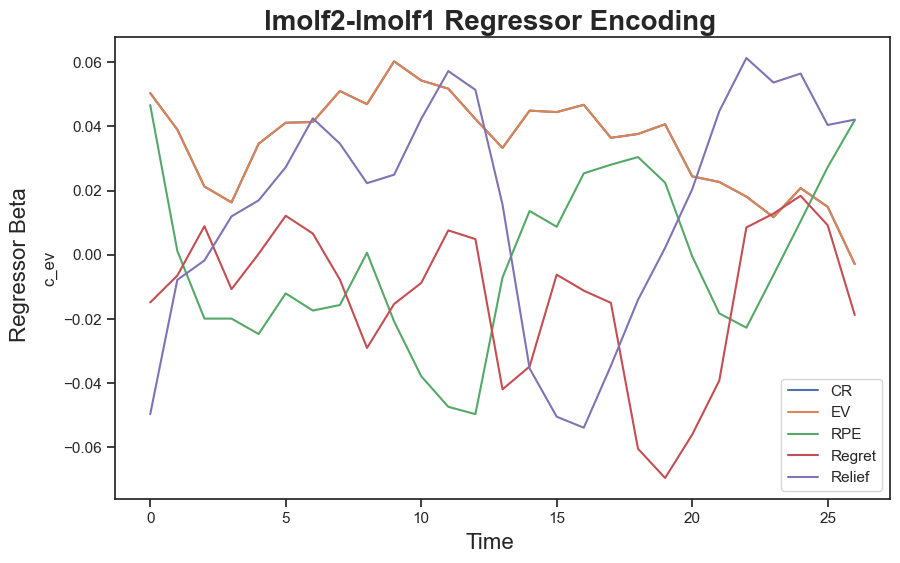

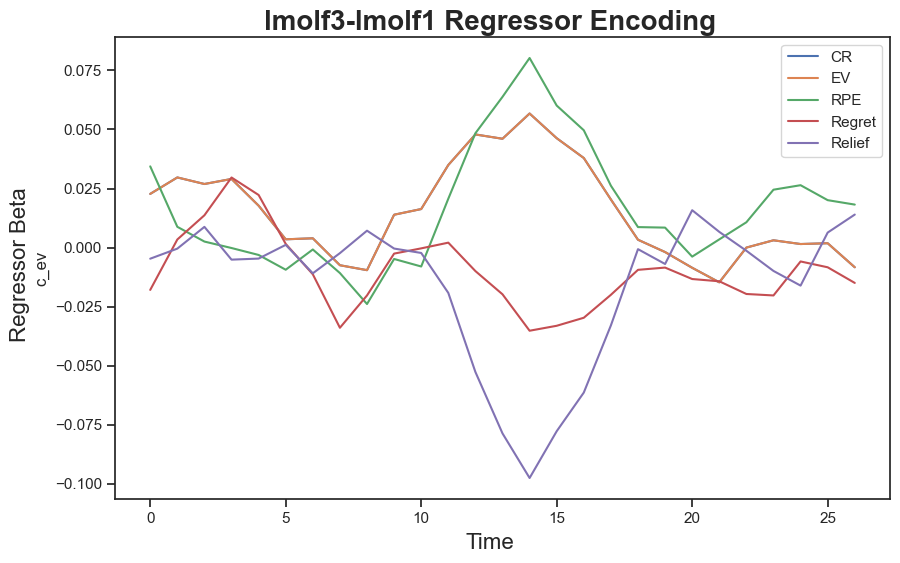

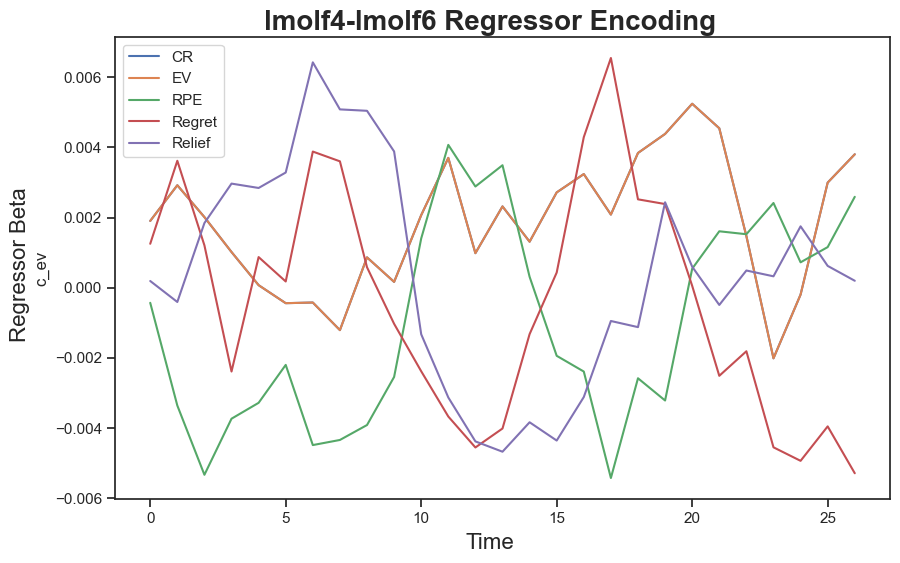

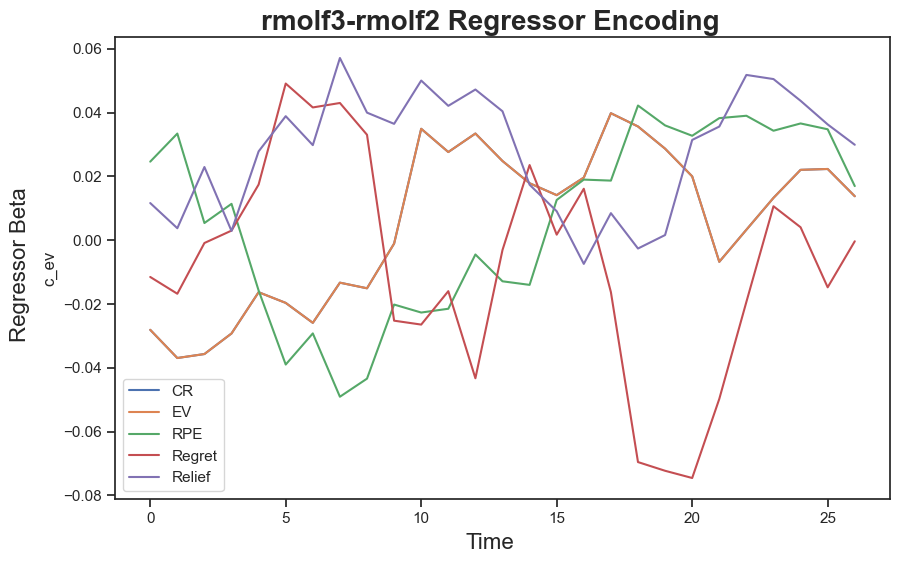

In [109]:
for ch in ofc_channels:
    fig,ax = plt.subplots(figsize=(10,6))
    sns.set_theme(style='ticks',font='Arial') 
    sns.lineplot(x=np.arange(0,len(ofc_reg_dict[ch])), y=ofc_reg_dict[ch]['c_ev'],label='CR')
    sns.lineplot(x=np.arange(0,len(ofc_reg_dict[ch])), y=ofc_reg_dict[ch]['c_ev'],label='EV')
    sns.lineplot(x=np.arange(0,len(ofc_reg_dict[ch])), y=ofc_reg_dict[ch]['rpe'],label='RPE')
    sns.lineplot(x=np.arange(0,len(ofc_reg_dict[ch])), y=ofc_reg_dict[ch]['dregret'],label='Regret')
    sns.lineplot(x=np.arange(0,len(ofc_reg_dict[ch])), y=ofc_reg_dict[ch]['drelief'],label='Relief')
    fig.suptitle(f'{ch} Regressor Encoding',font='Arial',weight ='semibold',fontsize=20,y=0.925)
    fig.supxlabel('Time',font='Arial',fontsize=16,y=0.02)
    fig.supylabel('Regressor Beta',font='Arial',fontsize=16)
    #ax.tick_params(labelsize=12)


### ACC

In [110]:
acc_reg_dict = {}
for ch in acc_channels:
    single_ch_data = power_epochs[event].copy().pick_channels([ch]).data[:,:,hfa_freq,0:1500].squeeze()
    acc_reg = time_resolved_regression(single_ch_data,regressors)
    acc_reg_dict[ch] = acc_reg
    

/var/folders/xk/q5rxx0ld0hnc9gjlq1dhwqhw0000gn/T/ipykernel_20927/2405717779.py:20: RuntimeWarning: Mean of empty slice
  smoothed_data[trial, :] = [np.nanmean(timeseries[trial, i:i+win_len]) for i in range(0, timeseries.shape[1], slide_len) if i+win_len <= timeseries.shape[1]]
/var/folders/xk/q5rxx0ld0hnc9gjlq1dhwqhw0000gn/T/ipykernel_20927/2405717779.py:20: RuntimeWarning: Mean of empty slice
  smoothed_data[trial, :] = [np.nanmean(timeseries[trial, i:i+win_len]) for i in range(0, timeseries.shape[1], slide_len) if i+win_len <= timeseries.shape[1]]
/var/folders/xk/q5rxx0ld0hnc9gjlq1dhwqhw0000gn/T/ipykernel_20927/2405717779.py:20: RuntimeWarning: Mean of empty slice
  smoothed_data[trial, :] = [np.nanmean(timeseries[trial, i:i+win_len]) for i in range(0, timeseries.shape[1], slide_len) if i+win_len <= timeseries.shape[1]]
/var/folders/xk/q5rxx0ld0hnc9gjlq1dhwqhw0000gn/T/ipykernel_20927/2405717779.py:20: RuntimeWarning: Mean of empty slice
  smoothed_data[trial, :] = [np.nanmean(timeser

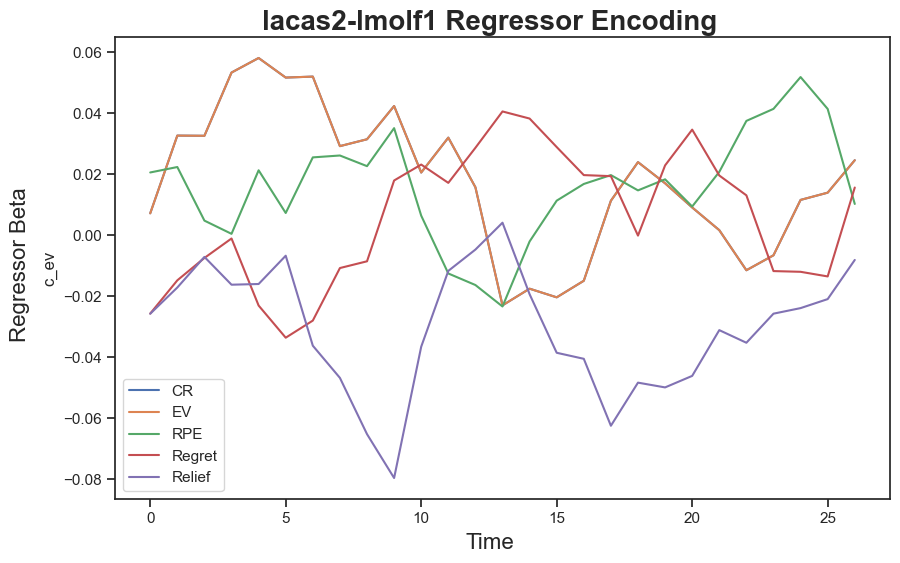

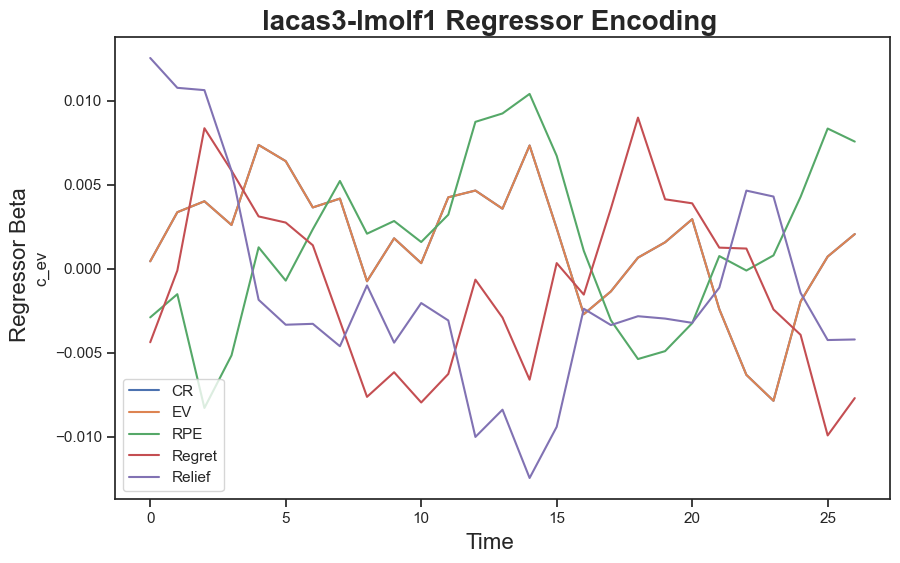

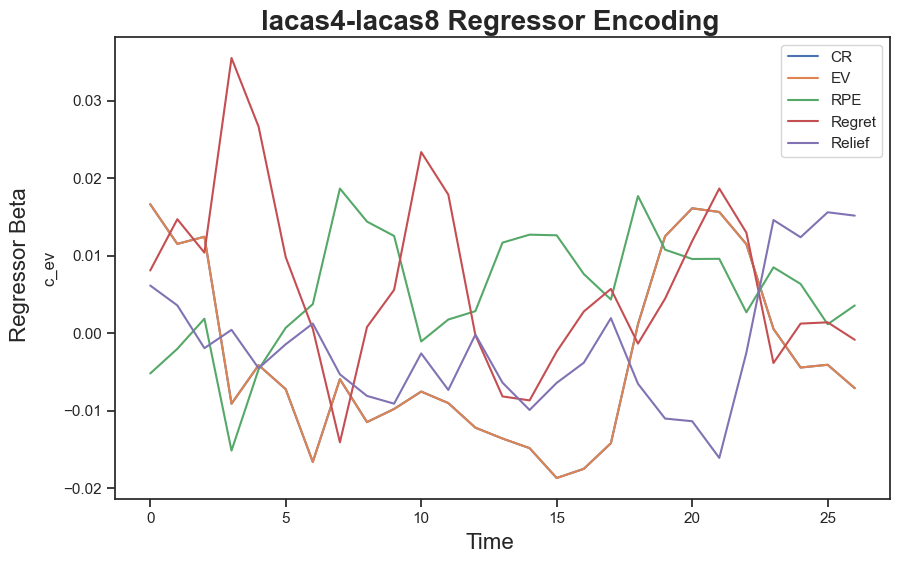

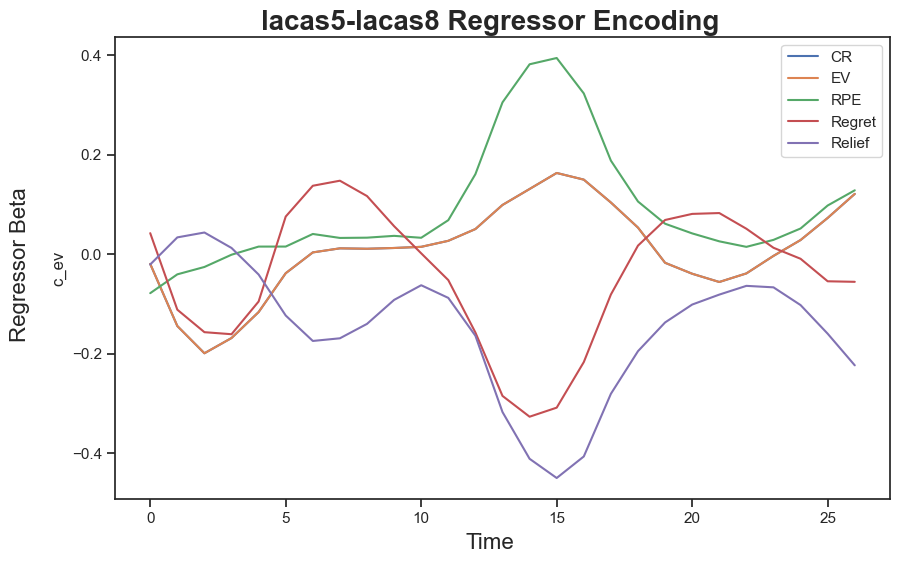

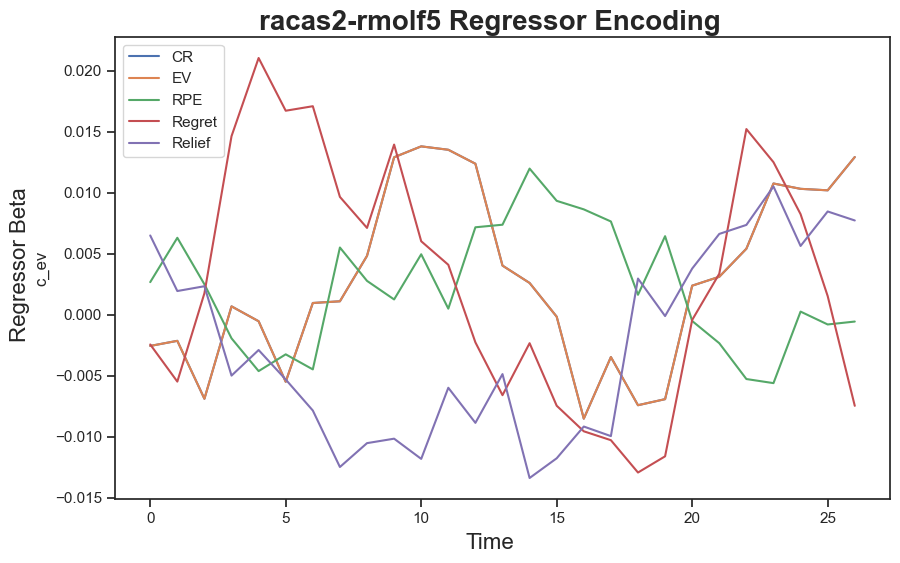

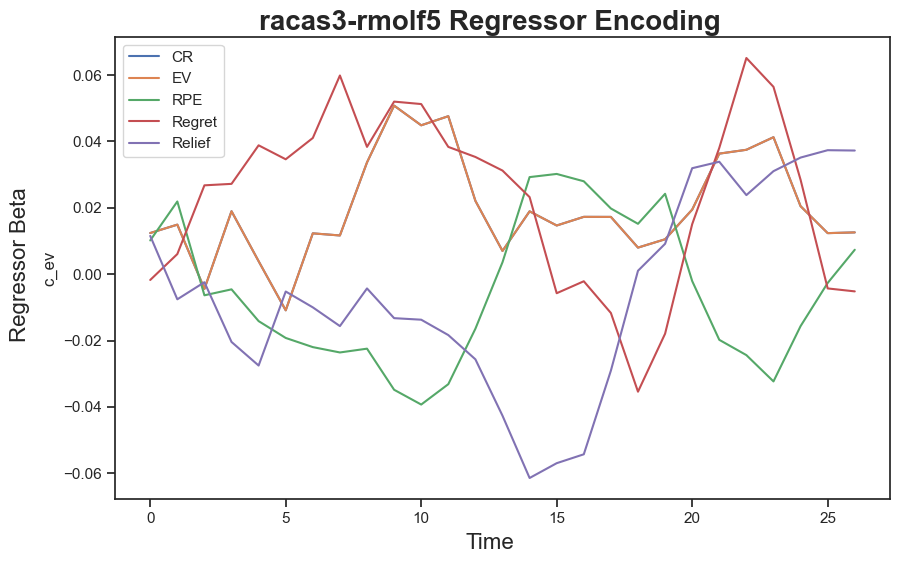

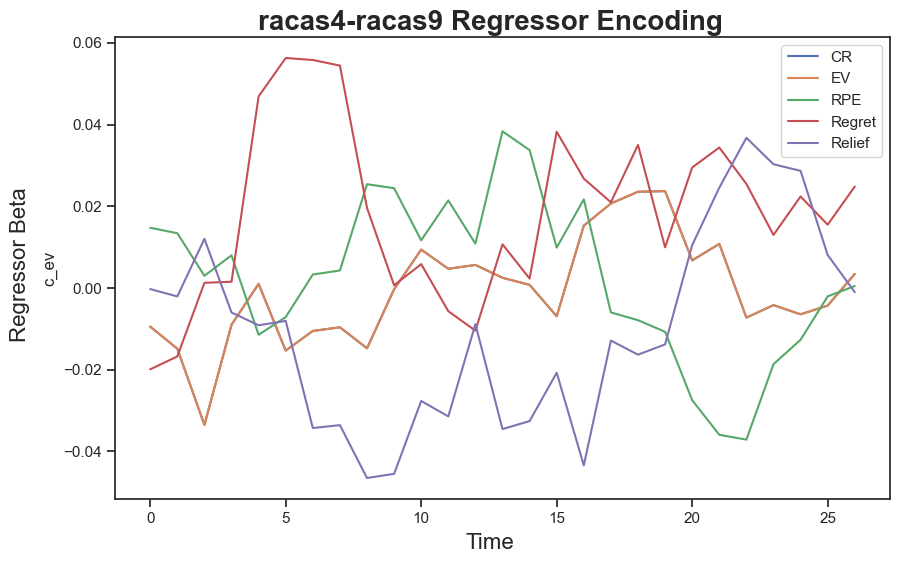

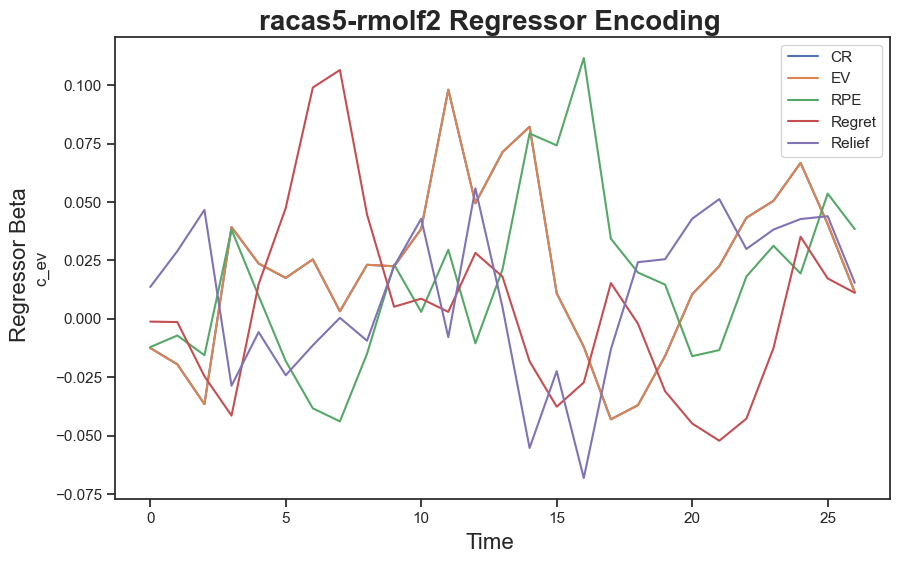

In [111]:
for ch in acc_channels:
    fig,ax = plt.subplots(figsize=(10,6))
    sns.set_theme(style='ticks',font='Arial') 
    sns.lineplot(x=np.arange(0,len(acc_reg_dict[ch])), y=acc_reg_dict[ch]['c_ev'],label='CR')
    sns.lineplot(x=np.arange(0,len(acc_reg_dict[ch])), y=acc_reg_dict[ch]['c_ev'],label='EV')
    sns.lineplot(x=np.arange(0,len(acc_reg_dict[ch])), y=acc_reg_dict[ch]['rpe'],label='RPE')
    sns.lineplot(x=np.arange(0,len(acc_reg_dict[ch])), y=acc_reg_dict[ch]['dregret'],label='Regret')
    sns.lineplot(x=np.arange(0,len(acc_reg_dict[ch])), y=acc_reg_dict[ch]['drelief'],label='Relief')
    fig.suptitle(f'{ch} Regressor Encoding',font='Arial',weight ='semibold',fontsize=20,y=0.925)
    fig.supxlabel('Time',font='Arial',fontsize=16,y=0.02)
    fig.supylabel('Regressor Beta',font='Arial',fontsize=16)
    #ax.tick_params(labelsize=12)


### Amy

In [112]:
amy_reg_dict = {}
for ch in amy_channels:
    single_ch_data = power_epochs[event].copy().pick_channels([ch]).data[:,:,hfa_freq,0:1500].squeeze()
    amy_reg = time_resolved_regression(single_ch_data,regressors)
    amy_reg_dict[ch] = amy_reg
    
    

/var/folders/xk/q5rxx0ld0hnc9gjlq1dhwqhw0000gn/T/ipykernel_20927/2405717779.py:20: RuntimeWarning: Mean of empty slice
  smoothed_data[trial, :] = [np.nanmean(timeseries[trial, i:i+win_len]) for i in range(0, timeseries.shape[1], slide_len) if i+win_len <= timeseries.shape[1]]


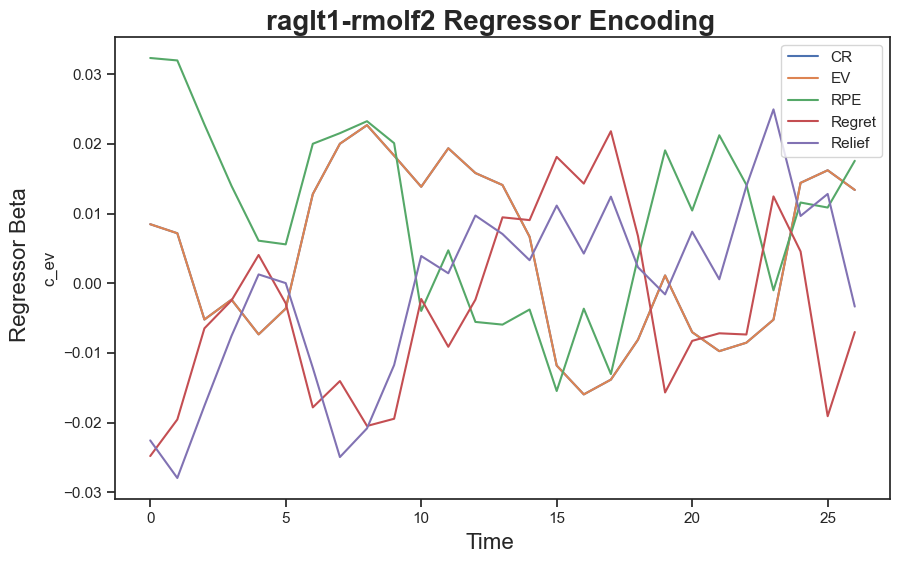

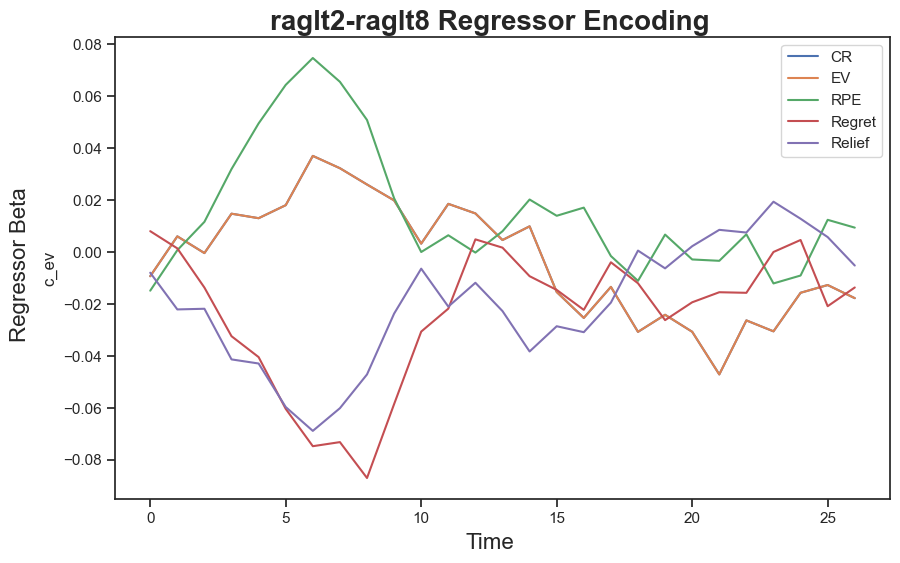

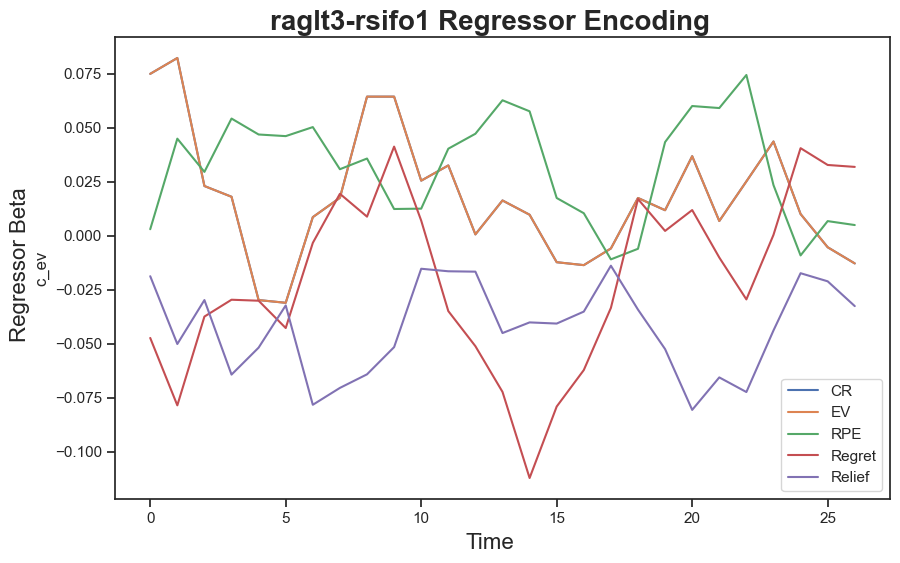

In [113]:
for ch in amy_channels:
    fig,ax = plt.subplots(figsize=(10,6))
    sns.set_theme(style='ticks',font='Arial') 
    sns.lineplot(x=np.arange(0,len(amy_reg_dict[ch])), y=amy_reg_dict[ch]['c_ev'],label='CR')
    sns.lineplot(x=np.arange(0,len(amy_reg_dict[ch])), y=amy_reg_dict[ch]['c_ev'],label='EV')
    sns.lineplot(x=np.arange(0,len(amy_reg_dict[ch])), y=amy_reg_dict[ch]['rpe'],label='RPE')
    sns.lineplot(x=np.arange(0,len(amy_reg_dict[ch])), y=amy_reg_dict[ch]['dregret'],label='Regret')
    sns.lineplot(x=np.arange(0,len(amy_reg_dict[ch])), y=amy_reg_dict[ch]['drelief'],label='Relief')
    fig.suptitle(f'{ch} Regressor Encoding',font='Arial',weight ='semibold',fontsize=20,y=0.925)
    fig.supxlabel('Time',font='Arial',fontsize=16,y=0.02)
    fig.supylabel('Regressor Beta',font='Arial',fontsize=16)
    #ax.tick_params(labelsize=12)


### Ant Insula

In [114]:
ins_reg_dict = {}
for ch in ins_channels:
    single_ch_data = power_epochs[event].copy().pick_channels([ch]).data[:,:,hfa_freq,0:1500].squeeze()
    ins_reg = time_resolved_regression(single_ch_data,regressors)
    ins_reg_dict[ch] = ins_reg
    
    

/var/folders/xk/q5rxx0ld0hnc9gjlq1dhwqhw0000gn/T/ipykernel_20927/2405717779.py:20: RuntimeWarning: Mean of empty slice
  smoothed_data[trial, :] = [np.nanmean(timeseries[trial, i:i+win_len]) for i in range(0, timeseries.shape[1], slide_len) if i+win_len <= timeseries.shape[1]]
/var/folders/xk/q5rxx0ld0hnc9gjlq1dhwqhw0000gn/T/ipykernel_20927/2405717779.py:20: RuntimeWarning: Mean of empty slice
  smoothed_data[trial, :] = [np.nanmean(timeseries[trial, i:i+win_len]) for i in range(0, timeseries.shape[1], slide_len) if i+win_len <= timeseries.shape[1]]
/var/folders/xk/q5rxx0ld0hnc9gjlq1dhwqhw0000gn/T/ipykernel_20927/2405717779.py:20: RuntimeWarning: Mean of empty slice
  smoothed_data[trial, :] = [np.nanmean(timeseries[trial, i:i+win_len]) for i in range(0, timeseries.shape[1], slide_len) if i+win_len <= timeseries.shape[1]]
/var/folders/xk/q5rxx0ld0hnc9gjlq1dhwqhw0000gn/T/ipykernel_20927/2405717779.py:20: RuntimeWarning: Mean of empty slice
  smoothed_data[trial, :] = [np.nanmean(timeser

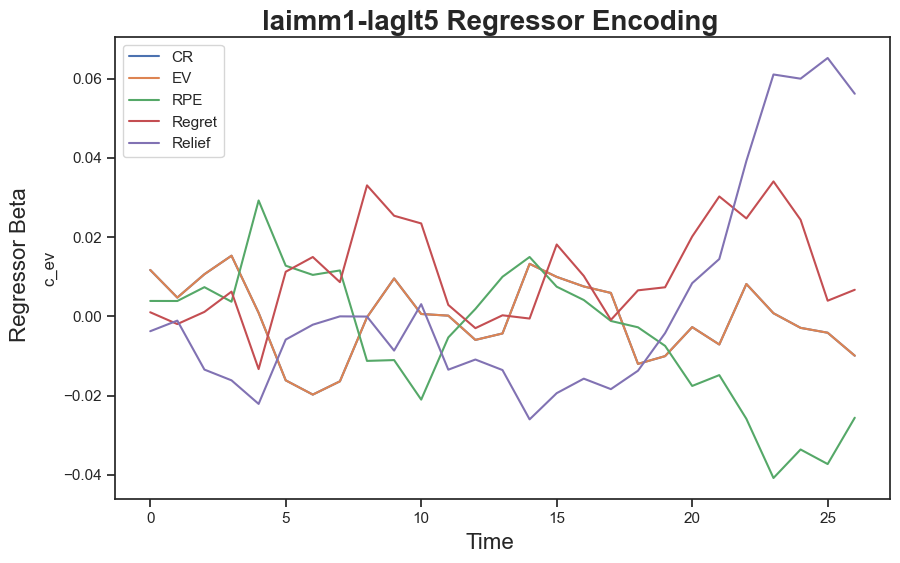

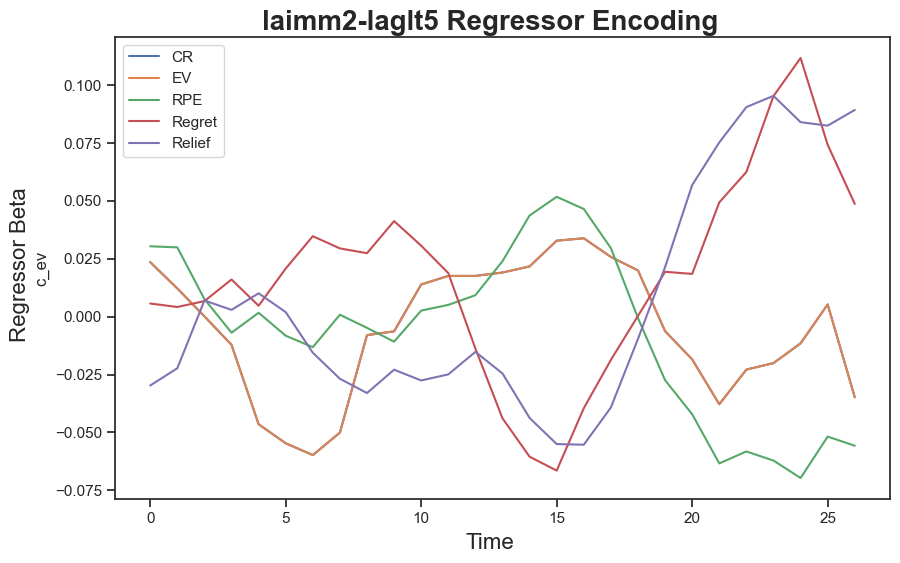

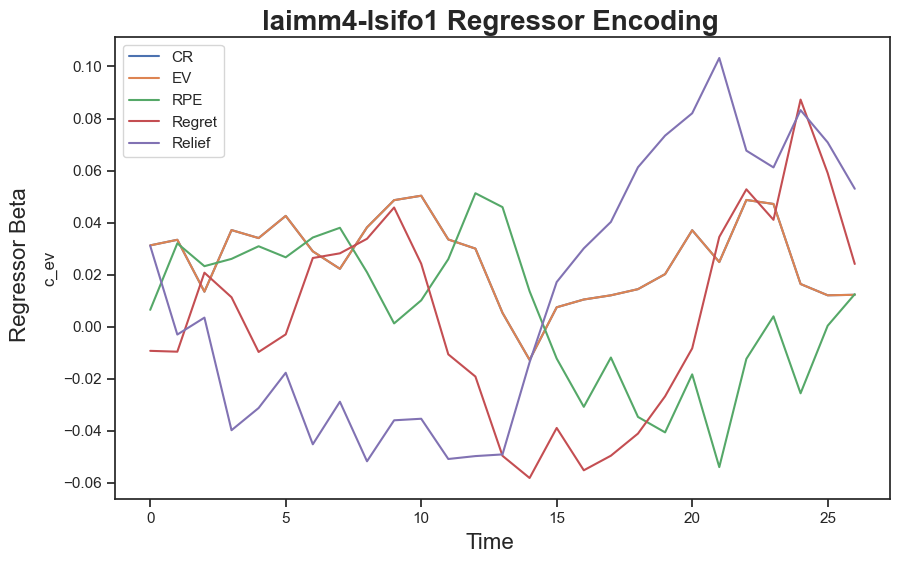

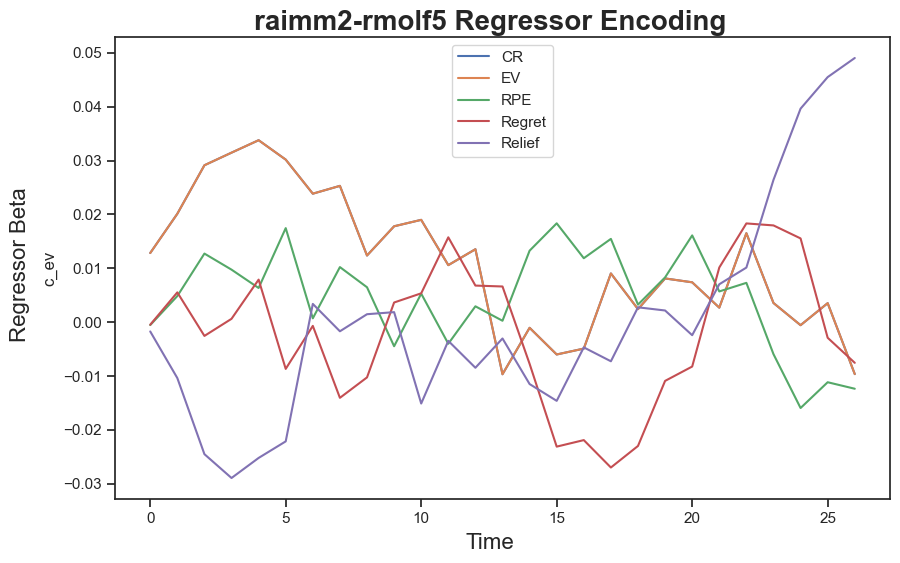

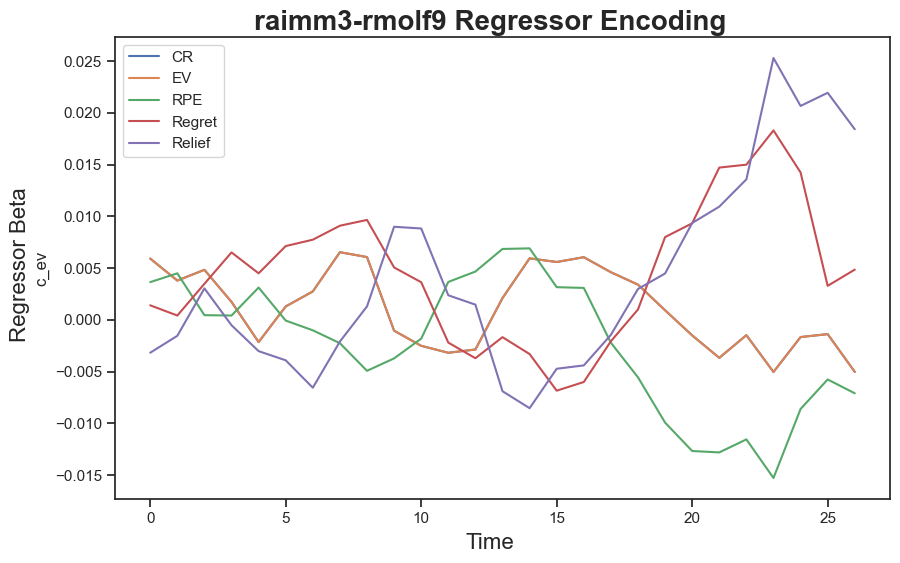

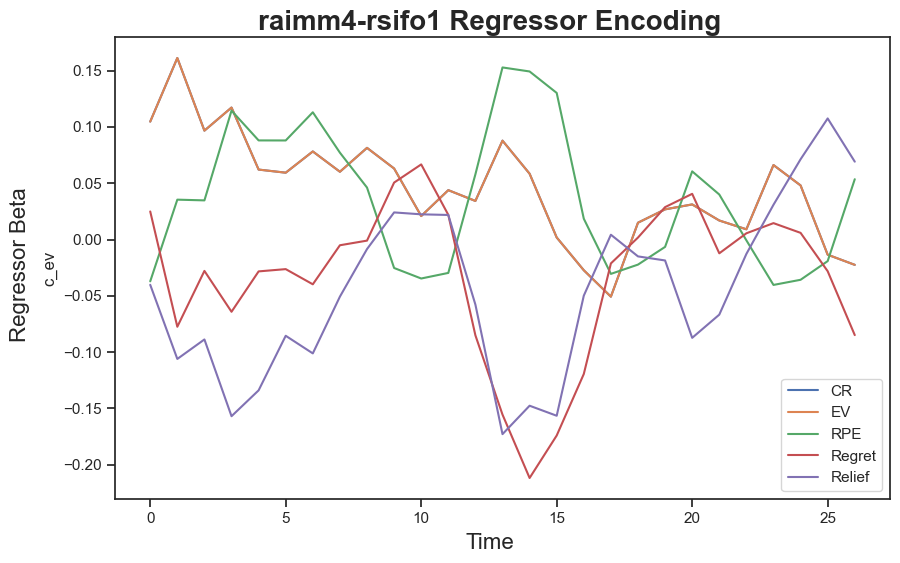

In [115]:
for ch in ins_channels:
    fig,ax = plt.subplots(figsize=(10,6))
    sns.set_theme(style='ticks',font='Arial') 
    sns.lineplot(x=np.arange(0,len(ins_reg_dict[ch])), y=ins_reg_dict[ch]['c_ev'],label='CR')
    sns.lineplot(x=np.arange(0,len(ins_reg_dict[ch])), y=ins_reg_dict[ch]['c_ev'],label='EV')
    sns.lineplot(x=np.arange(0,len(ins_reg_dict[ch])), y=ins_reg_dict[ch]['rpe'],label='RPE')
    sns.lineplot(x=np.arange(0,len(ins_reg_dict[ch])), y=ins_reg_dict[ch]['dregret'],label='Regret')
    sns.lineplot(x=np.arange(0,len(ins_reg_dict[ch])), y=ins_reg_dict[ch]['drelief'],label='Relief')
    fig.suptitle(f'{ch} Regressor Encoding',font='Arial',weight ='semibold',fontsize=20,y=0.925)
    fig.supxlabel('Time',font='Arial',fontsize=16,y=0.02)
    fig.supylabel('Regressor Beta',font='Arial',fontsize=16)
    #ax.tick_params(labelsize=12)
